In [3]:
#Import Modules
import pyart
import numpy as np
import matplotlib.pyplot as plt
import scipy
%matplotlib inline
from io import StringIO
from boto.s3.connection import S3Connection
import boto
from boto.s3.key import Key
import shutil, os, sys
import gzip
import pylab as plb
import matplotlib as mpl
import numpy.ma as ma
from pylab import *
#print(pyart.__version__)

/home/zsherman/anaconda3/lib/python3.5/site-packages/pyart/map/grid_mapper.py:40: DeprecationWarning: inspect.getargspec() is deprecated, use inspect.signature() instead
  from .ball_tree import BallTree
/home/zsherman/anaconda3/lib/python3.5/site-packages/ipykernel/pylab/config.py:66: DeprecationWarning: metadata {'config': True} was set from the constructor.  Metadata should be set using the .tag() method, e.g., Int().tag(key1='value1', key2='value2')
  inline backend."""
/home/zsherman/anaconda3/lib/python3.5/site-packages/ipykernel/pylab/config.py:71: DeprecationWarning: metadata {'config': True} was set from the constructor.  Metadata should be set using the .tag() method, e.g., Int().tag(key1='value1', key2='value2')
  'retina', 'jpeg', 'svg', 'pdf'.""")
/home/zsherman/anaconda3/lib/python3.5/site-packages/ipykernel/pylab/config.py:85: DeprecationWarning: metadata {'config': True} was set from the constructor.  Metadata should be set using the .tag() method, e.g., Int().tag(key1=

In [4]:
#gzip and opening CPOL files
LOCAL_PATH = '/home/zsherman/Documents/Jupyter/'
filenames = []
conn = S3Connection(anon=True)
bucket = conn.get_bucket('testradar', validate=False)
bucket_list = bucket.list()
for l in bucket_list:
    keyString = str(l.key)
    print(keyString)
    if '.gz' in keyString:
        l.get_contents_to_filename(LOCAL_PATH+keyString)
        filenames.append(LOCAL_PATH+keyString[0:-3])
        gzfh = gzip.open(LOCAL_PATH+keyString, 'rb')
        ofh = open(LOCAL_PATH+keyString[0:-3], 'wb')
        for line in gzfh:
            ofh.write(line)
        ofh.close()
        gzfh.close()
        os.remove(LOCAL_PATH+keyString)

CSU_unfolded/
CSU_unfolded/CPOL_corr_20060122_082009_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_083009_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_084009_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_085009_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_090008_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_091008_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_092008_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_093013_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_094009_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_095009_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_100009_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_101009_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_102008_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_103009_vt_unfolded_hand.cfrad.nc.gz
CSU_unfolded/CPOL_corr_20060122_10

In [36]:
#Defining and running all files through the pyart dealias algorithm
def corrected_velocity_region(radar):
    sw_sel = 0
    sw_num = radar.nsweeps
    sw_elevs = [radar.fixed_angle['data'][sw] for sw in range(0, sw_num-1)]
    el_sel = sw_elevs[sw_sel]
    
    corr_vel_region = pyart.correct.dealias_region_based(
    radar, interval_splits=3, vel_field='velocity', rays_wrap_around=True, keep_original=False, 
    nyquist_vel=ny_vel, centered = True)
    radar.add_field('corrected_velocity_region', corr_vel_region, replace_existing = True)

In [15]:
#Defining and displaying reflectivity field for all files.
def reflectivity_fields(radar):
    dZ = radar.fields['reflectivity']['data']
    dZ_mean = ma.mean(dZ)
    dZ_std = ma.std(dZ)
    dZ_max = ma.max(dZ)
    indxs = ma.where(dZ == ma.max(dZ))

    print('Statistics of reflectivity field: %.0f' % (dZ_mean) + " +/- " + '%.0f' % (dZ_std))

In [16]:
#Finding the dealiased difference from the changes done by pyart.
def dealiasing_differences_func_region(radar, ny_vel):
    diff_reg = radar.fields['corrected_velocity_region']['data'] - radar.fields['velocity']['data']
    diff_reg_sc = diff_reg/ny_vel
    diff_region = radar.fields['corrected_velocity_region']
    diff_region['data'] = diff_reg_sc
    diff_region['long_name'] = 'Region Dealiased Added Nyquist intervals'
    diff_region['standard_name'] = "region_added_Ny_intervals"
    diff_region['units']=''
    radar.add_field('dealiasing_differences_sc_region', diff_region, replace_existing = True)

In [17]:
def dealiasing_differences_func_hand(radar, ny_vel):
    cv_attribute_name = ''
    if ('corrected_velocity' in radar_file.fields):
        cv_attribute_name = 'corrected_velocity'
    elif ('corrected_velocity2' in radar_file.fields):
        cv_attribute_name = 'corrected_velocity2'
    else:
        raise Exception('key not found')
    diff_ha = radar.fields[cv_attribute_name]['data'] - radar.fields['velocity']['data']
    diff_ha_sc = diff_ha/ny_vel
    diff_hand = radar.fields[cv_attribute_name]
    diff_hand['data'] = diff_ha_sc
    diff_hand['long_name'] = 'Hand Dealiased Added Nyquist intervals'
    diff_hand['standard_name'] = "hand_added_Ny_intervals"
    diff_hand['units']=''
    radar.add_field('dealiasing_differences_sc_hand', diff_hand, replace_existing = True)

In [18]:
def correction_difference(radar):
    correction_diff = ma.asanyarray((radar.fields['dealiasing_differences_sc_hand']['data'] - radar.fields['dealiasing_differences_sc_region']['data'])/ny_vel)
    if ma.any(correction_diff > 0):
        print(radar.sweep_number)
        print(correction_diff)
        return correction_diff

In [19]:
def region_hand_diff_sweep(radar):
    cv_attribute_name = ''
    if ('corrected_velocity' in radar_file.fields):
        cv_attribute_name = 'corrected_velocity'
    elif ('corrected_velocity2' in radar_file.fields):
        cv_attribute_name = 'corrected_velocity2'
    else:
        raise Exception('key not found')
        
    corr_vel_region = pyart.correct.dealias_region_based(
    radar, interval_splits=3, vel_field='velocity', rays_wrap_around=True, keep_original=False, 
    nyquist_vel=ny_vel, centered = True)
    radar.add_field('corrected_velocity_region', corr_vel_region, replace_existing = True)
    sweep_0_slice = radar.get_slice(0)
    region_hand_diff = ma.asanyarray((radar.fields[cv_attribute_name]['data'][sweep_0_slice] - 
                                      radar.fields['corrected_velocity_region']['data'][sweep_0_slice])
                                     /ny_vel)
    print(region_hand_diff)
    return region_hand_diff

In [20]:
def region_hand_diff(radar):
    cv_attribute_name = ''
    if ('corrected_velocity' in radar_file.fields):
        cv_attribute_name = 'corrected_velocity'
    elif ('corrected_velocity2' in radar_file.fields):
        cv_attribute_name = 'corrected_velocity2'
    else:
        raise Exception('key not found')  
    corr_vel_region = pyart.correct.dealias_region_based(
    radar, interval_splits=3, vel_field='velocity', rays_wrap_around=True, keep_original=False, 
    nyquist_vel=ny_vel, centered = True)
    radar.add_field('corrected_velocity_region', corr_vel_region, replace_existing = True)
    region_hand_diff = ma.asanyarray(((radar.fields[cv_attribute_name]['data']) - 
                                      (radar.fields['corrected_velocity_region']['data']))/ny_vel)
    if ma.any(region_hand_diff > 0):
        print(radar.sweep_number)
        print(region_hand_diff)
        return radar.sweep_number
        return region_hand_diff

In [37]:
radar_files = []
for filename in filenames:
    radar_file = pyart.io.read(filename)
    radar_files += [radar_file]  

In [34]:
radar_files = []
for filename in filenames:
    radar_file = pyart.io.read(filename)
    radar_files += [radar_file]  
    ny_vel = radar_file.instrument_parameters['nyquist_velocity']['data'][0]
    print(filename)
    region_hand_diff(radar_file)

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_082009_vt_unfolded_hand.cfrad.nc
{'data': array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16], dtype=int32), '_FillValue': -9999, 'long_name': 'sweep_index_number_0_based', 'units': ''}
[[-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 ..., 
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]]
/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_083009_vt_unfolded_hand.cfrad.nc
{'data': array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16], dtype=int32), '_FillValue': -9999, 'long_name': 'sweep_index_number_0_based', 'units': ''}
[[-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 ..., 
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]]
/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_084009_vt_unfolded_hand.cfrad.nc
{'data': array([ 0,  1,  2

KeyboardInterrupt: 

In [14]:
radar_files = []
for filename in filenames:
    radar_file = pyart.io.read(filename)
    radar_files += [radar_file]  
    ny_vel = radar_file.instrument_parameters['nyquist_velocity']['data'][0]
    print(filename)
    corrected_velocity_region(radar_file)
    dealiasing_differences_func_region(radar_file, ny_vel)
    dealiasing_differences_func_hand(radar_file, ny_vel)
    correction_difference(radar_file)

{'data': array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16], dtype=int32), 'units': '', '_FillValue': -9999, 'long_name': 'sweep_index_number_0_based'}
[[-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 ..., 
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]]
{'data': array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16], dtype=int32), 'units': '', '_FillValue': -9999, 'long_name': 'sweep_index_number_0_based'}
[[-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 ..., 
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]]
{'data': array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16], dtype=int32), 'units': '', '_FillValue': -9999, 'long_name': 'sweep_index_number_0_based'}
[[-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 ..., 
 [-- -- -- ..., -- -- --]
 [-- -- -- ..., -- -- --]
 [-- --

In [21]:
def velocity_data(radar):
    velocity = ma.asanyarray(radar.fields['velocity']['data'])
    print (velocity)
    return velocity

In [24]:
def corrected_velocity_data(radar):
    cv_attribute_name = ''
    if ('corrected_velocity' in radar_file.fields):
        cv_attribute_name = 'corrected_velocity'
    elif ('corrected_velocity2' in radar_file.fields):
        cv_attribute_name = 'corrected_velocity2'
    else:
        raise Exception('key not found')
    corrected_velocity = ma.asanyarray(radar.fields[cv_attribute_name]['data'])
    print(corrected_velocity)
    return corrected_velocity

In [25]:
#Number of hand-dealiased gates that occured.
def n_gates_hand(radar):
    dealias_hands = []
    dealias_hand = ma.asanyarray(radar.fields['dealiasing_differences_sc_hand']['data'])
    dealias_hands += [dealias_hand]
    n_gates_hand = np.count_nonzero(dealias_hand != 0)
    print("Number of Gates Hand Dealiased")
    return n_gates_hand

In [26]:
#Number of region-dealiased gates that occur.
def n_gates_region(radar):
    dealias_regions = []
    dealias_region = ma.asanyarray(radar.fields['dealiasing_differences_sc_region']['data'])
    dealias_regions += [dealias_region]
    n_gates_region = np.count_nonzero(dealias_region != 0)
    print("Number of Gates Region Dealiased")
    return n_gates_region

In [33]:
radar_files = []
for filename in filenames:
    radar_file = pyart.io.read(filename)
    radar_files += [radar_file]  
    ny_vel = radar_file.instrument_parameters['nyquist_velocity']['data'][0]
    corrected_velocity_region(radar_file)
  
    dealiasing_differences_func_region(radar_file, ny_vel)
    #Putting each radar_file through the dealiasing difference function.
    dealiasing_differences_func_hand(radar_file, ny_vel)
    print(filename)
    print(n_gates_hand(radar_file))
    print(n_gates_region(radar_file))

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_082009_vt_unfolded_hand.cfrad.nc


TypeError: 'int' object is not callable

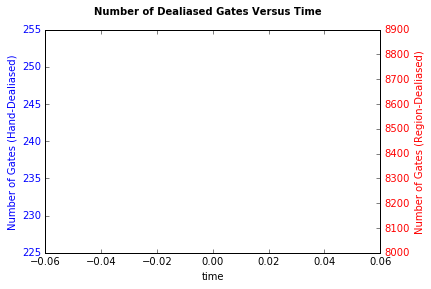

In [30]:
dealias_regions = []
n_gates_regions = []
dealias_hands = []
n_gates_hands = []
times = []
for radar_file in radar_files:
    dealias_hand = ma.asanyarray(radar_file.fields['dealiasing_differences_sc_hand']['data'])
    dealias_hands += [dealias_hand]
    n_gates_hand = (np.count_nonzero(dealias_hand != 0))
    dealias_region = ma.asanyarray(radar_file.fields['dealiasing_differences_sc_region']['data'])
    dealias_regions += [dealias_region]
    n_gates_region = (np.count_nonzero(dealias_region != 0))
    n_gates_regions +=[n_gates_region]
    n_gates_hands +=[n_gates_hand]
    time = np.array(radar_file.time)
    times += [time]
    dealias_hands += [dealias_hand]
fig, ax1 = plt.subplots()
fig.suptitle('Number of Dealiased Gates Versus Time', fontsize=10, fontweight='bold')
y1 = n_gates_hands
ax1.plot(y1, 'b-')
ax1.set_xlabel('time')
#ax1.set_xlabel(radar_file.time['standard_name'] + ' (' + radar_file.time['units'] + ')')
# Make the y-axis label and tick labels match the line color.
ax1.set_ylabel('Number of Gates (Hand-Dealiased)', color='b')
for tl in ax1.get_yticklabels():
    tl.set_color('b')
plt.ylim()
x = times
plt.xlim()
ax2 = ax1.twinx()
y2 = n_gates_regions
ax2.plot(y2, 'r-')
ax2.set_ylabel('Number of Gates (Region-Dealiased)', color='r')
for tl in ax2.get_yticklabels():
    tl.set_color('r')
plt.ylim()
plt.show()
#Plot gates and time

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_082009_vt_unfolded_hand.cfrad.nc


/home/zsherman/anaconda3/lib/python3.5/site-packages/IPython/core/formatters.py:92: DeprecationWarning: DisplayFormatter._ipython_display_formatter_default is deprecated: use @default decorator instead.
  def _ipython_display_formatter_default(self):
/home/zsherman/anaconda3/lib/python3.5/site-packages/IPython/core/formatters.py:669: DeprecationWarning: PlainTextFormatter._singleton_printers_default is deprecated: use @default decorator instead.
  def _singleton_printers_default(self):


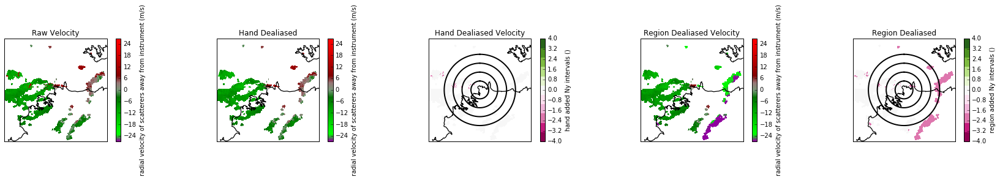

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_083009_vt_unfolded_hand.cfrad.nc


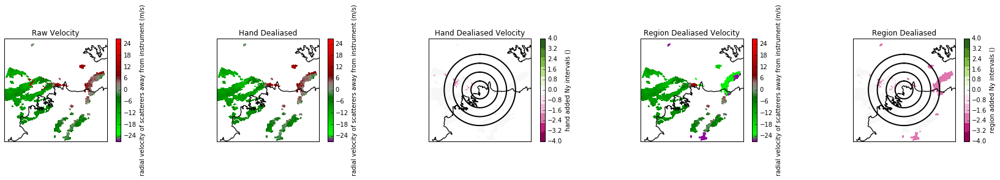

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_084009_vt_unfolded_hand.cfrad.nc


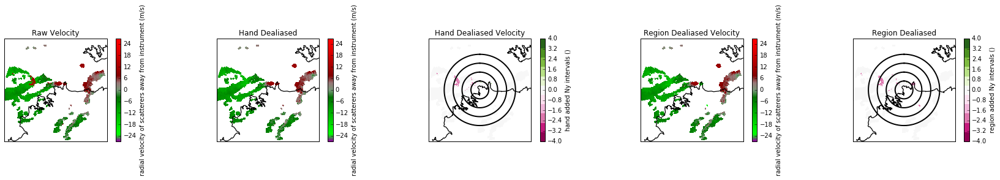

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_085009_vt_unfolded_hand.cfrad.nc


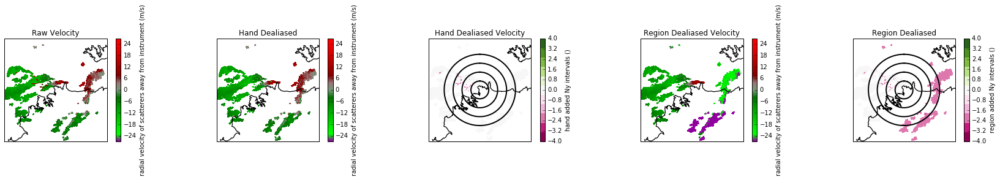

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_090008_vt_unfolded_hand.cfrad.nc


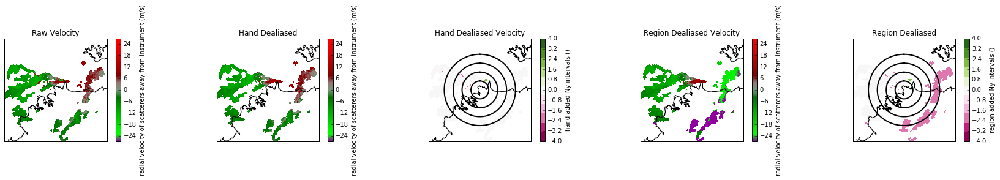

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_091008_vt_unfolded_hand.cfrad.nc


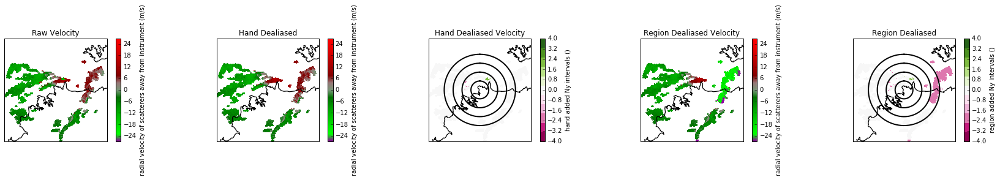

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_092008_vt_unfolded_hand.cfrad.nc


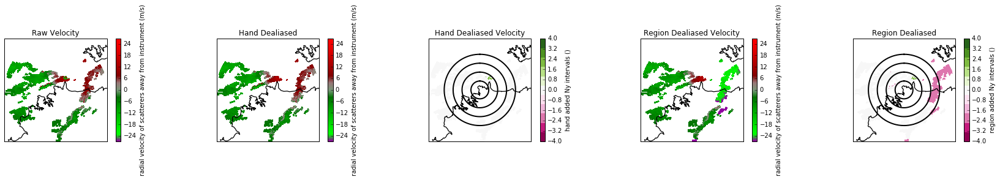

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_093013_vt_unfolded_hand.cfrad.nc


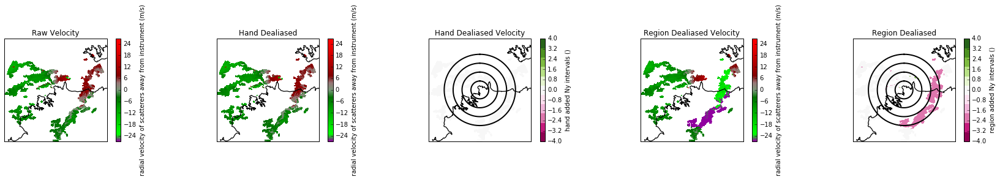

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_094009_vt_unfolded_hand.cfrad.nc


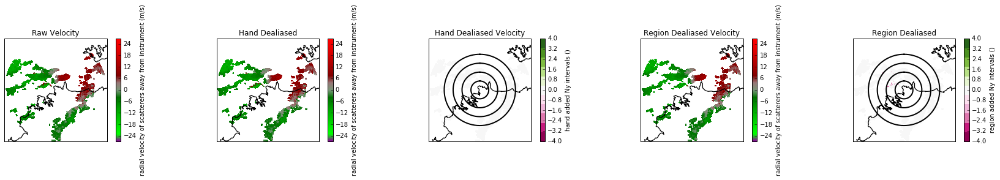

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_095009_vt_unfolded_hand.cfrad.nc


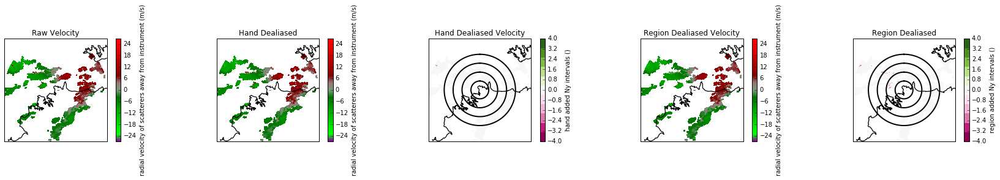

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_100009_vt_unfolded_hand.cfrad.nc


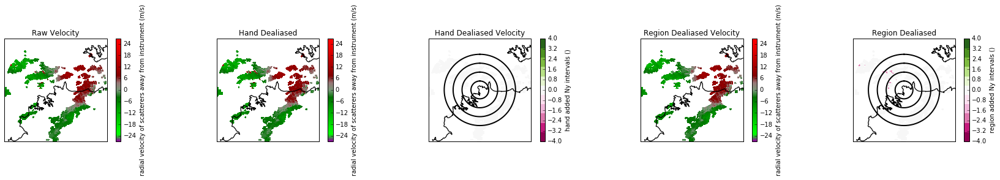

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_101009_vt_unfolded_hand.cfrad.nc


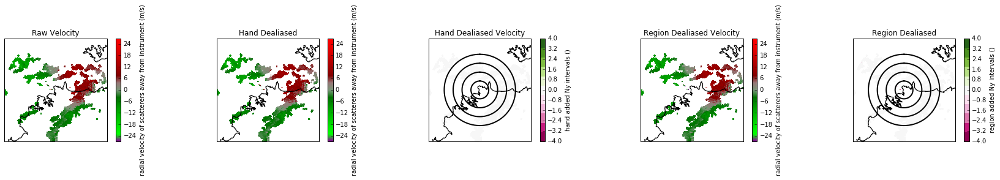

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_102008_vt_unfolded_hand.cfrad.nc


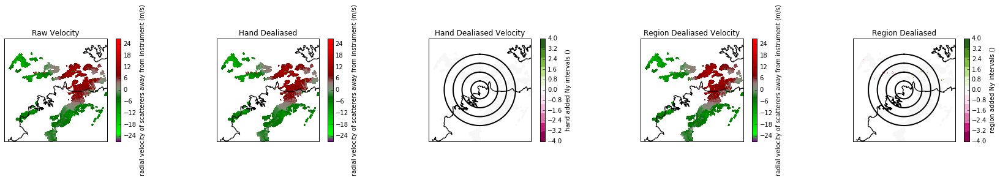

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_103009_vt_unfolded_hand.cfrad.nc


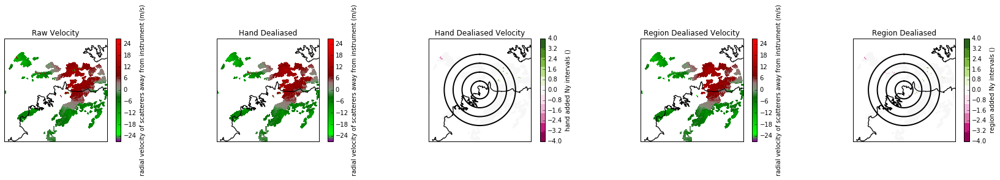

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_104009_vt_unfolded_hand.cfrad.nc


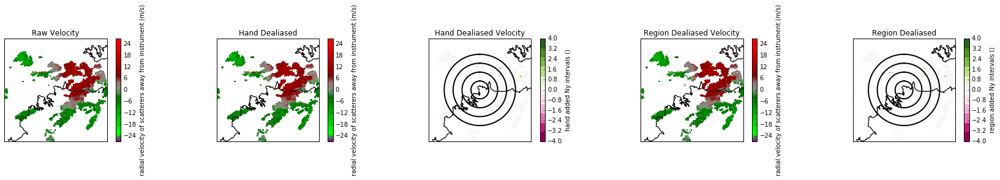

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_105009_vt_unfolded_hand.cfrad.nc


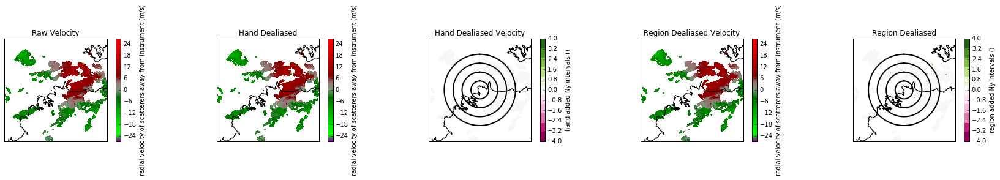

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_110009_vt_unfolded_hand.cfrad.nc


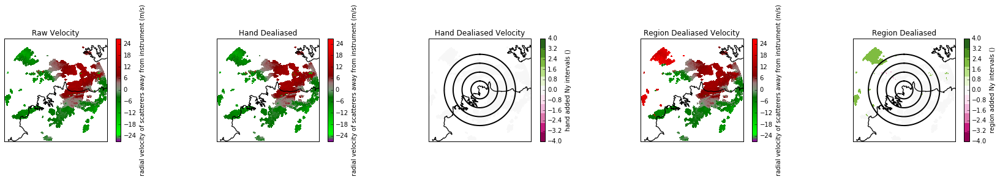

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_111009_vt_unfolded_hand.cfrad.nc


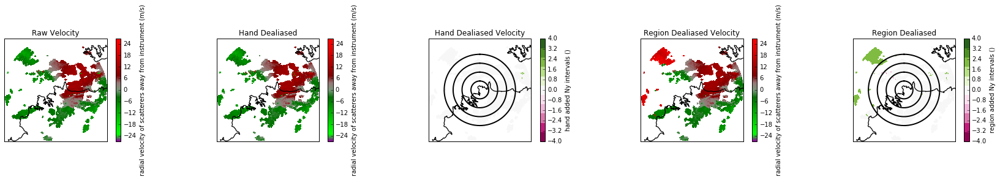

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_112009_vt_unfolded_hand.cfrad.nc


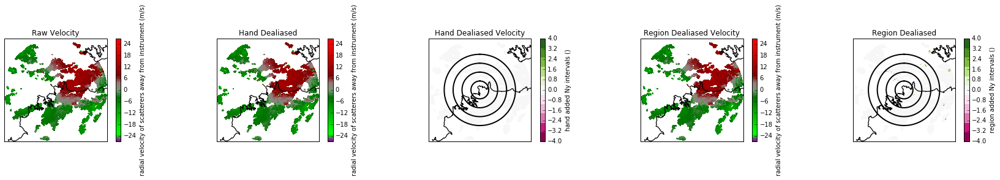

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_113009_vt_unfolded_hand.cfrad.nc


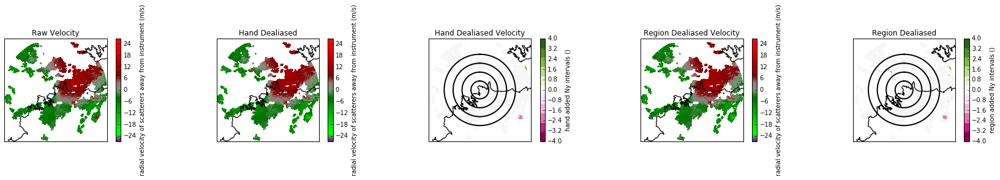

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_114009_vt_unfolded_hand.cfrad.nc


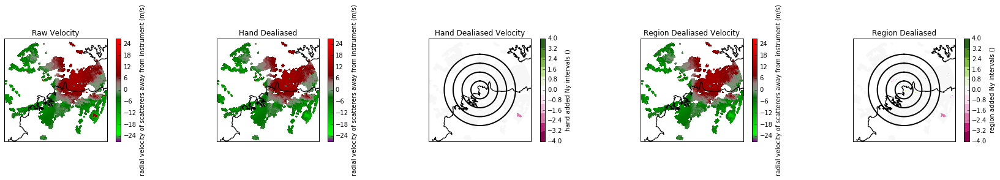

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_115008_vt_unfolded_hand.cfrad.nc


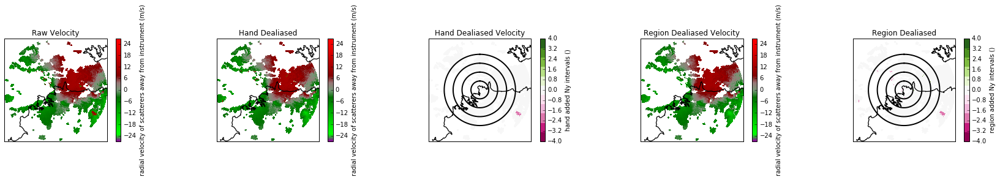

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_120008_vt_unfolded_hand.cfrad.nc


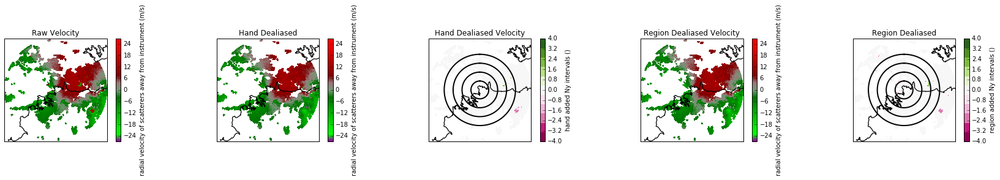

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_121008_vt_unfolded_hand.cfrad.nc


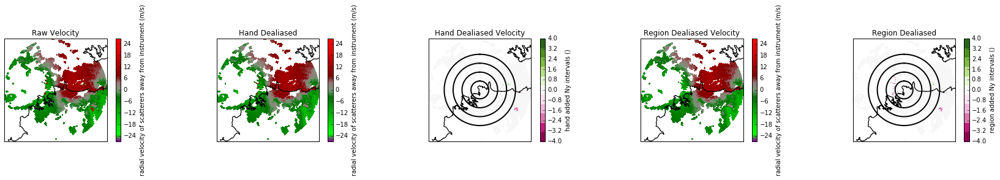

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_122009_vt_unfolded_hand.cfrad.nc


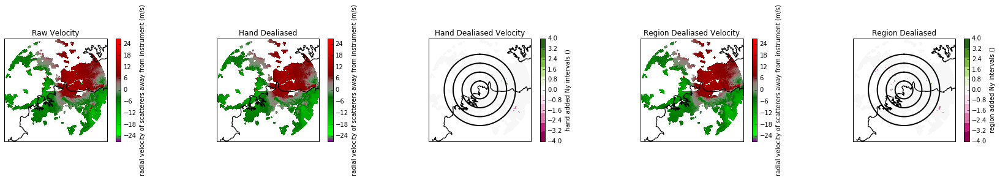

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_123009_vt_unfolded_hand.cfrad.nc


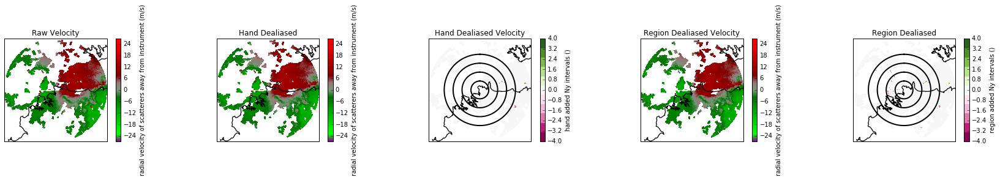

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_124009_vt_unfolded_hand.cfrad.nc


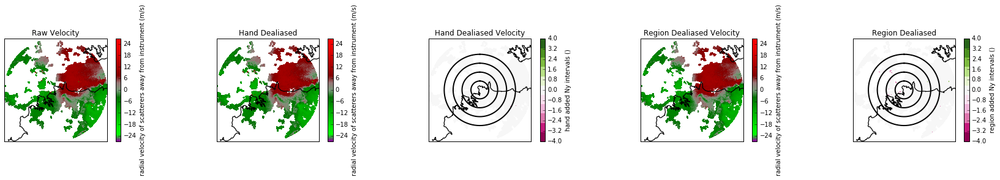

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_125009_vt_unfolded_hand.cfrad.nc


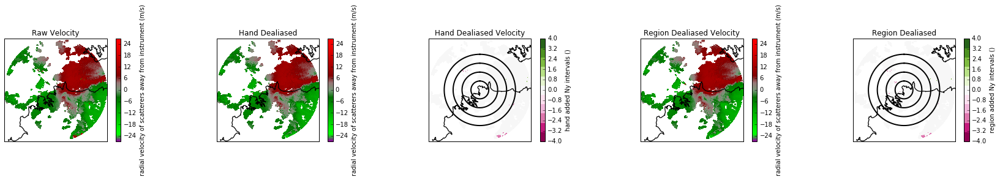

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_130009_vt_unfolded_hand.cfrad.nc


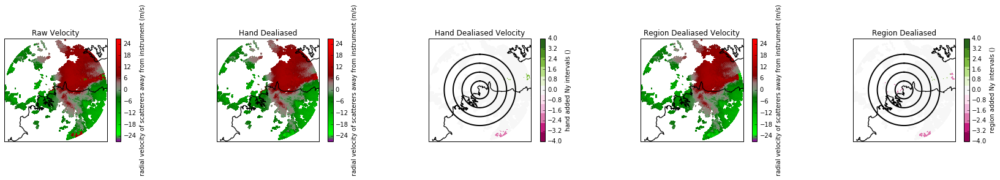

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_131010_vt_unfolded_hand.cfrad.nc


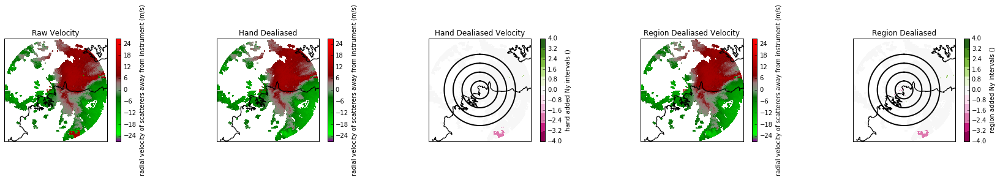

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_132009_vt_unfolded_hand.cfrad.nc


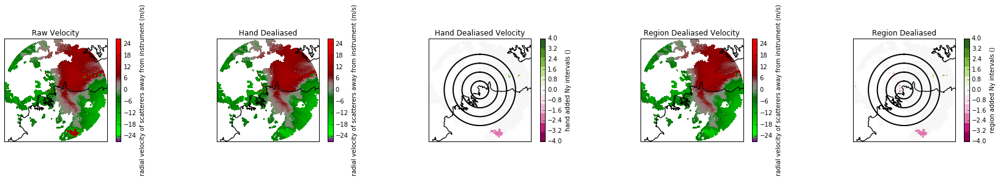

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_133009_vt_unfolded_hand.cfrad.nc


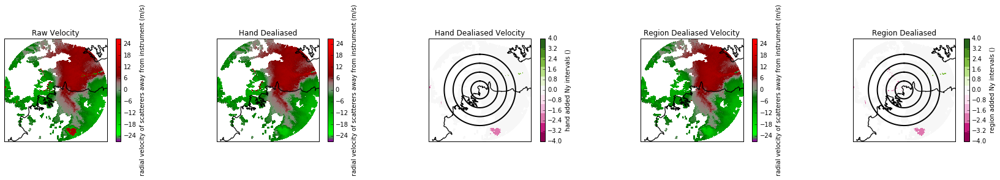

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_134009_vt_unfolded_hand.cfrad.nc


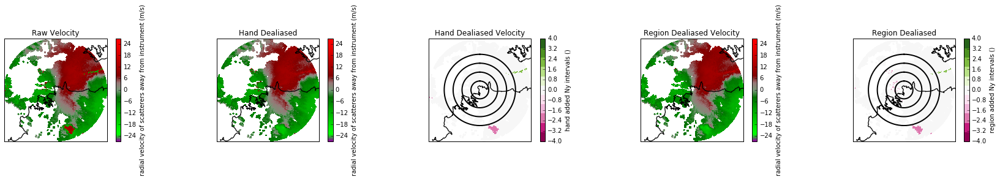

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_135009_vt_unfolded_hand.cfrad.nc


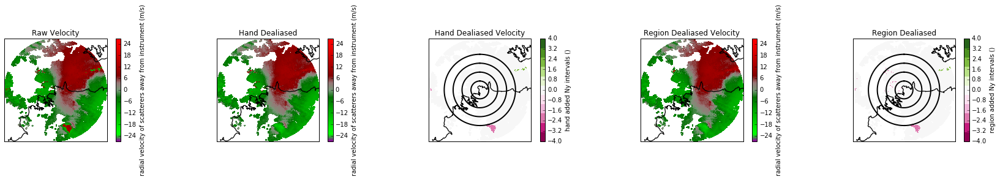

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_140009_vt_unfolded_hand.cfrad.nc


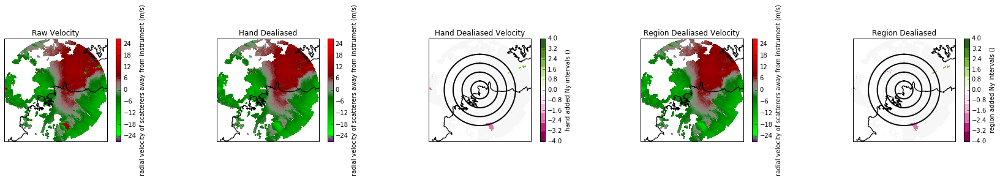

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_141010_vt_unfolded_hand.cfrad.nc


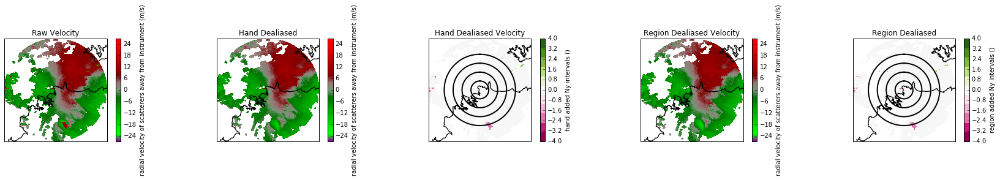

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_142009_vt_unfolded_hand.cfrad.nc


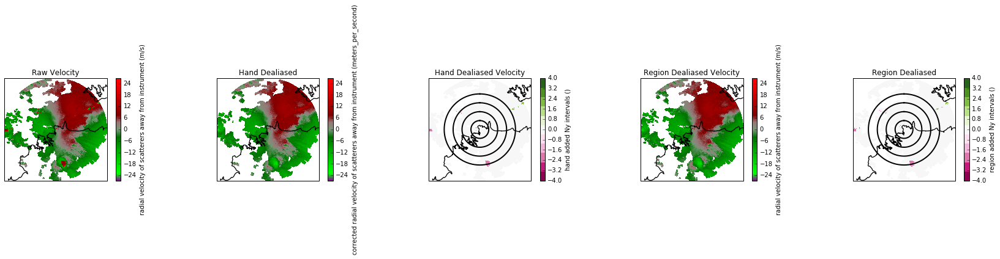

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_143009_vt_unfolded_hand.cfrad.nc


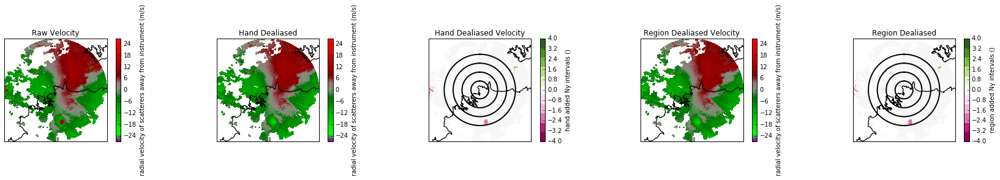

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_144009_vt_unfolded_hand.cfrad.nc


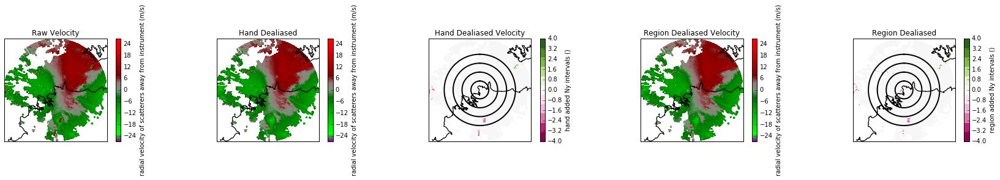

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_145009_vt_unfolded_hand.cfrad.nc


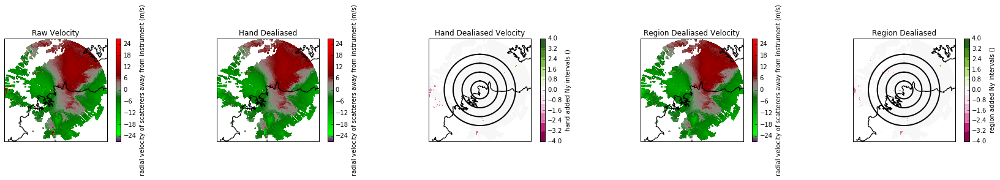

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_150009_vt_unfolded_hand.cfrad.nc


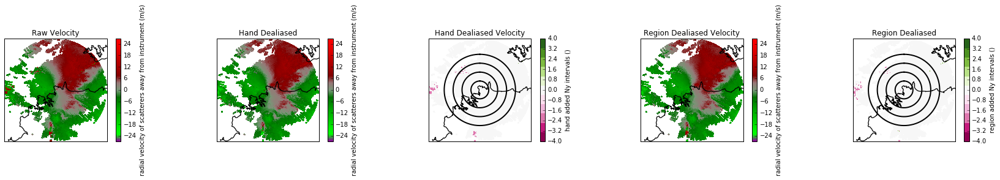

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_151010_vt_unfolded_hand.cfrad.nc


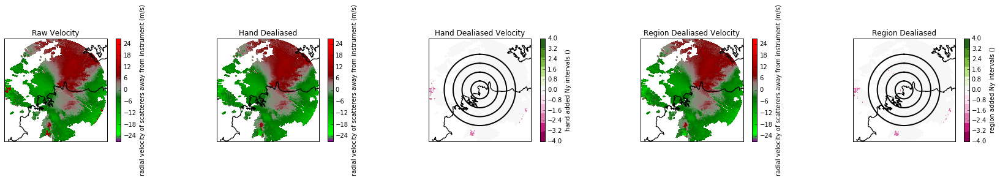

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_152009_vt_unfolded_hand.cfrad.nc


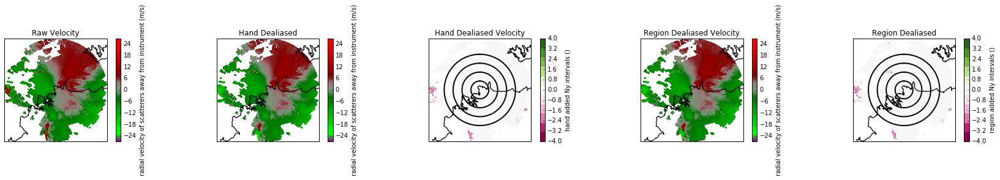

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_153009_vt_unfolded_hand.cfrad.nc


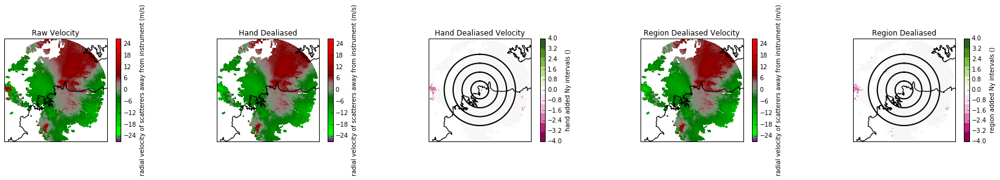

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_154009_vt_unfolded_hand.cfrad.nc


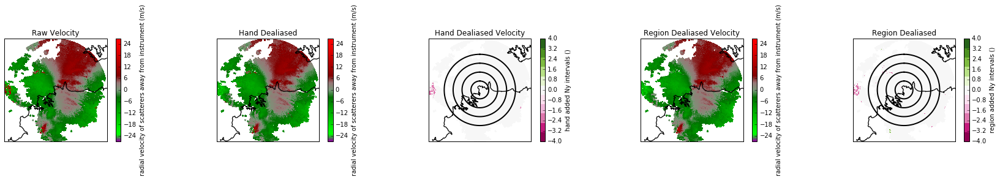

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_155008_vt_unfolded_hand.cfrad.nc


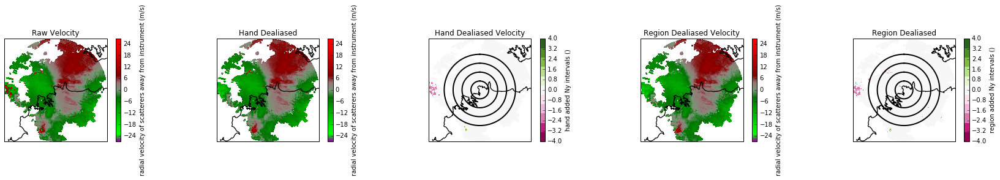

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_160008_vt_unfolded_hand.cfrad.nc


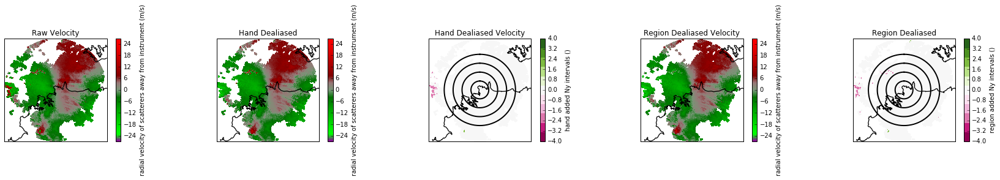

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_161010_vt_unfolded_hand.cfrad.nc


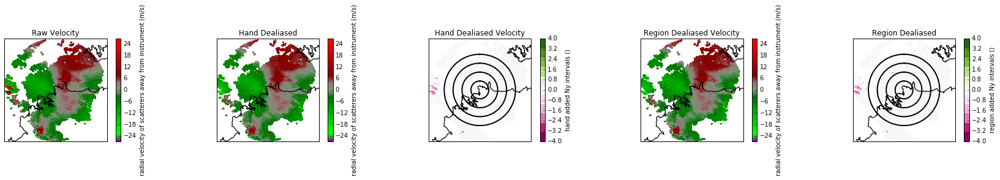

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_162008_vt_unfolded_hand.cfrad.nc


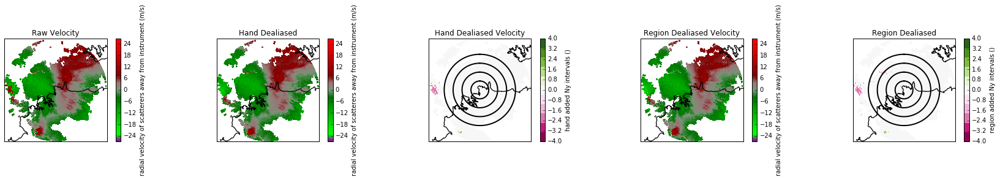

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_163009_vt_unfolded_hand.cfrad.nc


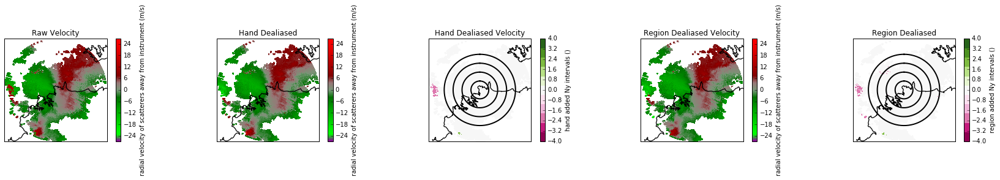

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_164009_vt_unfolded_hand.cfrad.nc


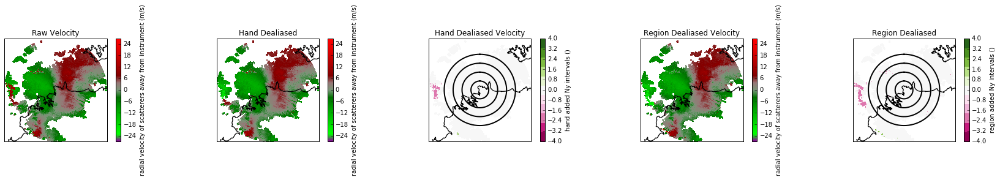

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_165009_vt_unfolded_hand.cfrad.nc


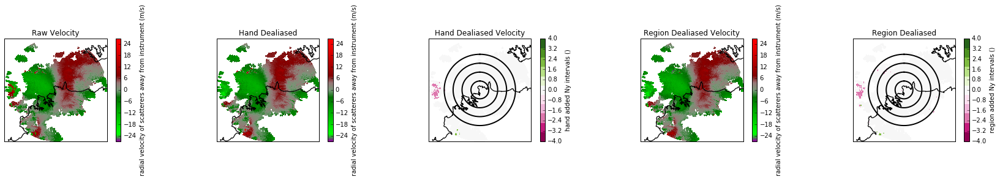

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_170009_vt_unfolded_hand.cfrad.nc


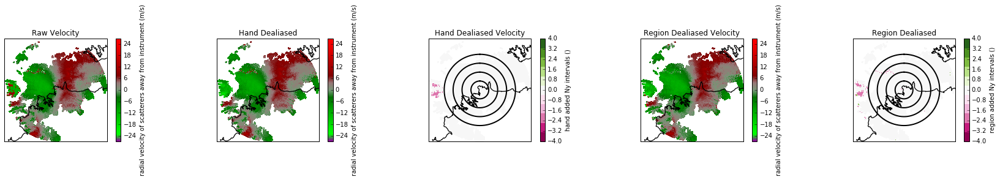

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_171010_vt_unfolded_hand.cfrad.nc


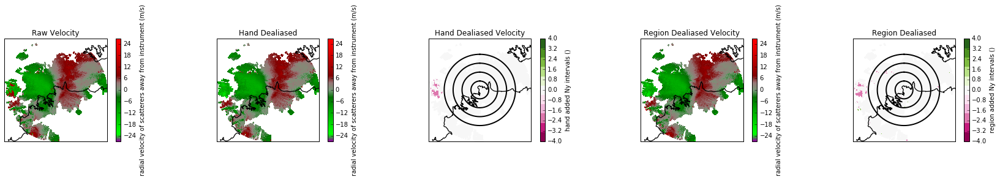

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_172009_vt_unfolded_hand.cfrad.nc


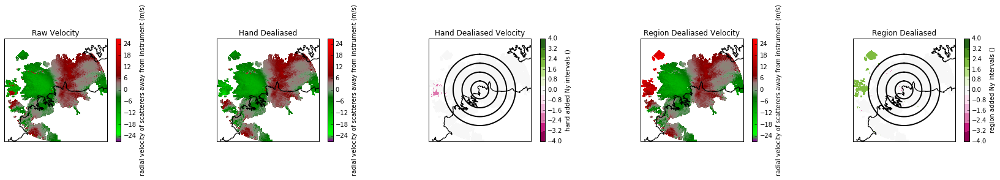

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_173009_vt_unfolded_hand.cfrad.nc


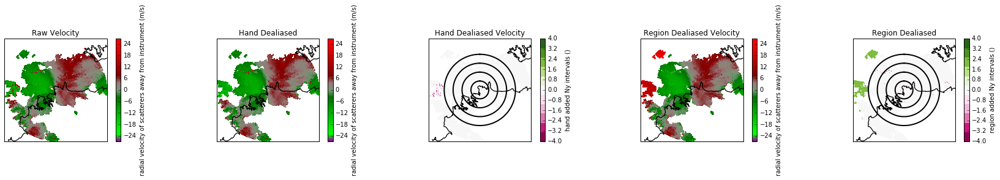

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_174009_vt_unfolded_hand.cfrad.nc


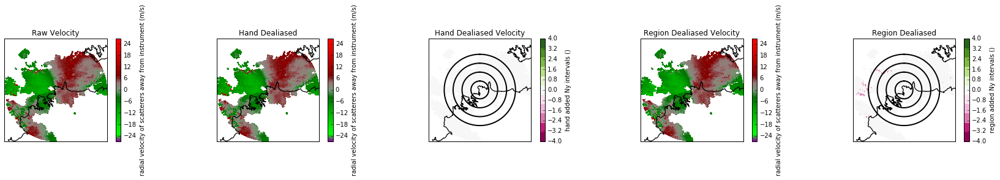

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_175009_vt_unfolded_hand.cfrad.nc


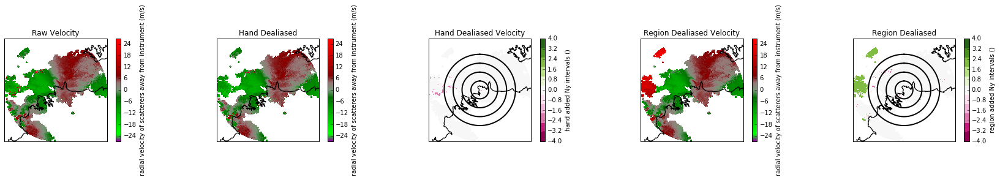

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_180009_vt_unfolded_hand.cfrad.nc


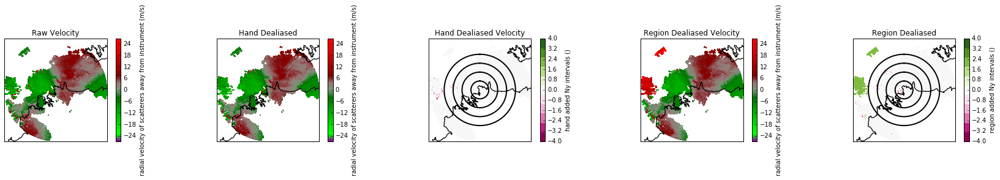

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_181010_vt_unfolded_hand.cfrad.nc


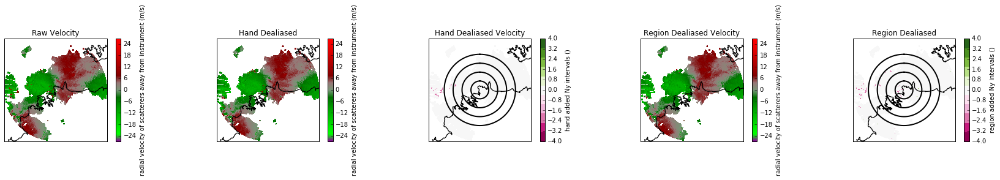

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_182009_vt_unfolded_hand.cfrad.nc


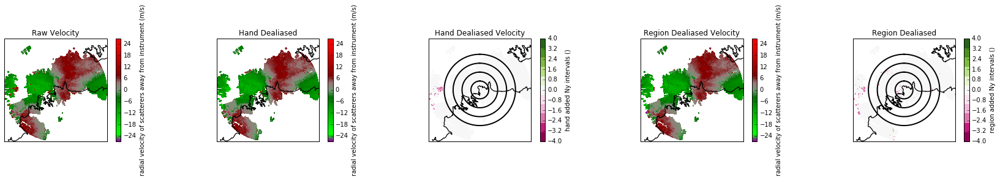

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_183009_vt_unfolded_hand.cfrad.nc


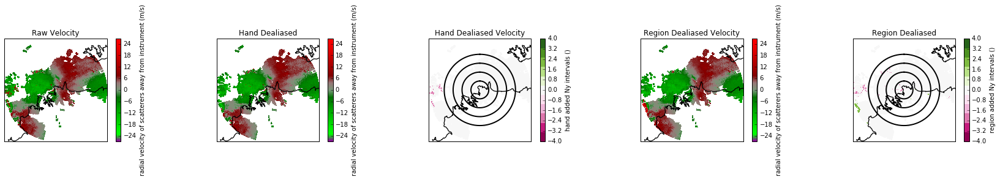

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_184009_vt_unfolded_hand.cfrad.nc


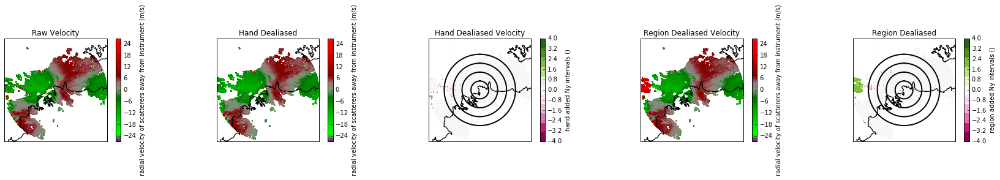

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_185009_vt_unfolded_hand.cfrad.nc


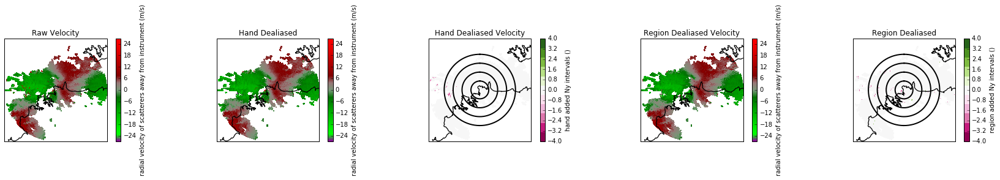

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_190009_vt_unfolded_hand.cfrad.nc


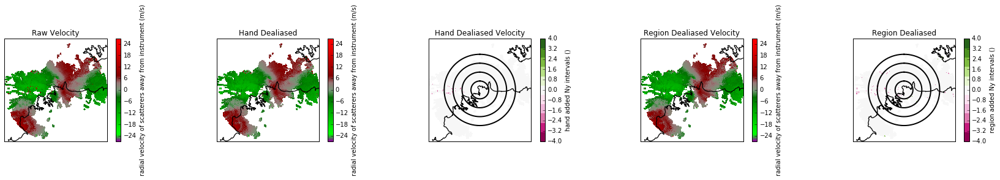

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_191010_vt_unfolded_hand.cfrad.nc


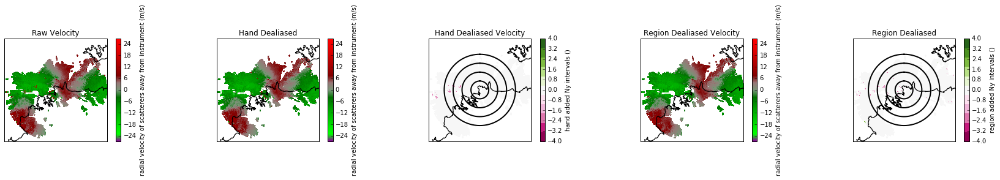

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_192009_vt_unfolded_hand.cfrad.nc


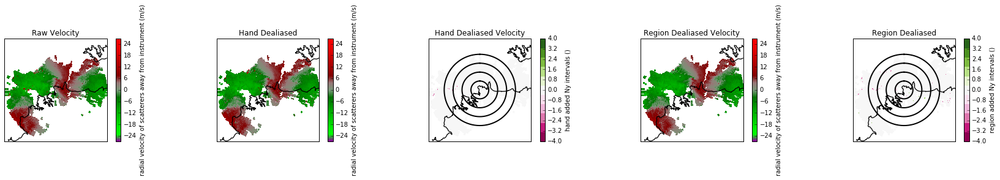

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_193009_vt_unfolded_hand.cfrad.nc


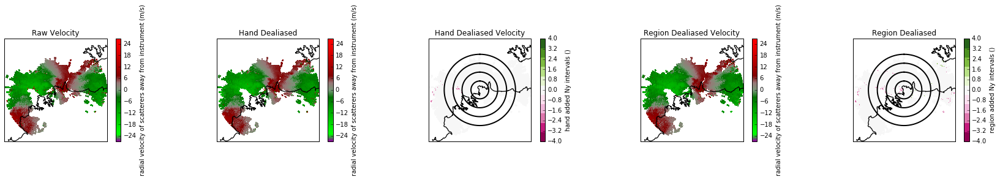

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_194009_vt_unfolded_hand.cfrad.nc


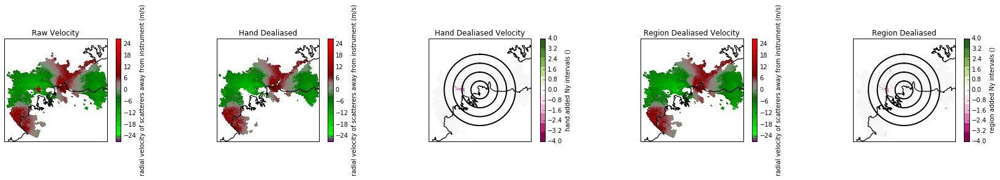

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_195008_vt_unfolded_hand.cfrad.nc


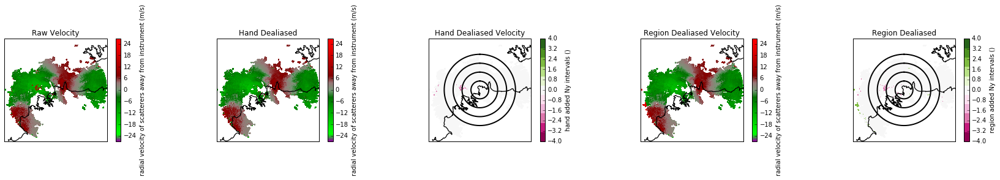

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_200008_vt_unfolded_hand.cfrad.nc


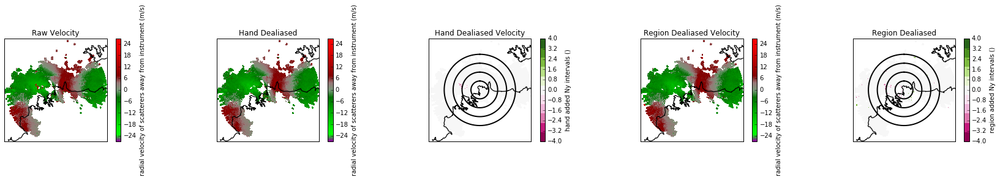

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_201010_vt_unfolded_hand.cfrad.nc


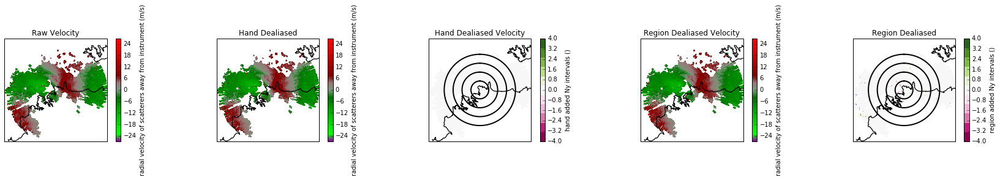

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_202009_vt_unfolded_hand.cfrad.nc


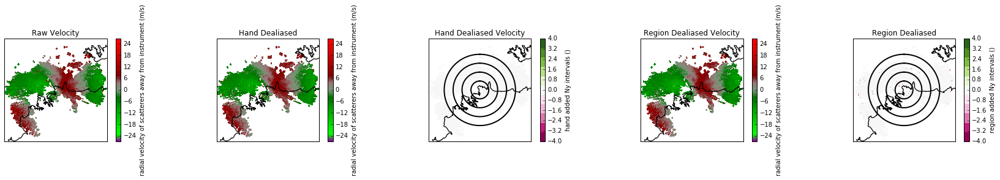

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_203009_vt_unfolded_hand.cfrad.nc


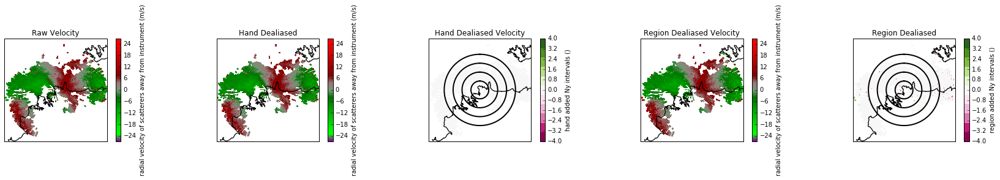

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_204009_vt_unfolded_hand.cfrad.nc


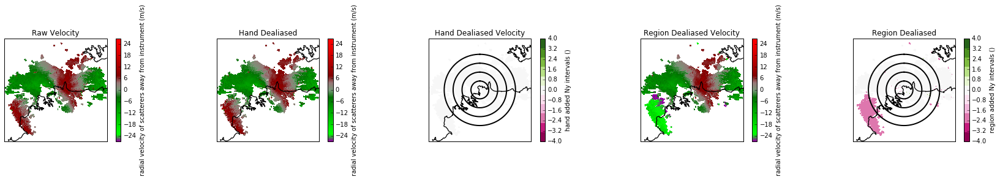

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_205009_vt_unfolded_hand.cfrad.nc


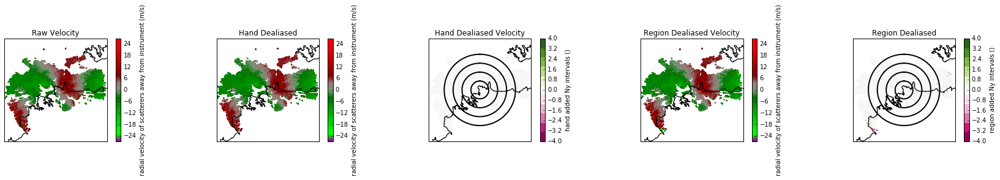

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_210009_vt_unfolded_hand.cfrad.nc


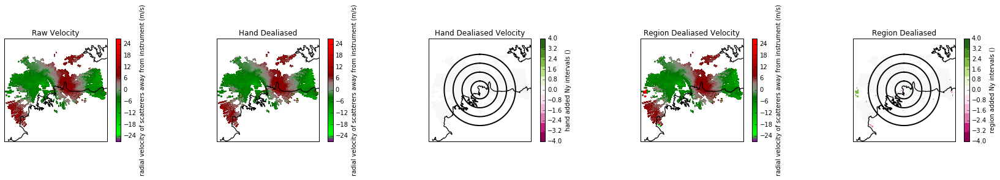

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_211010_vt_unfolded_hand.cfrad.nc


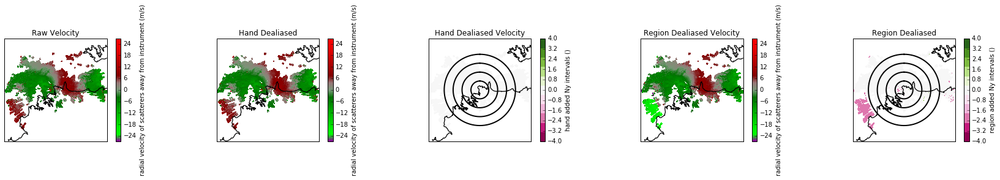

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_212009_vt_unfolded_hand.cfrad.nc


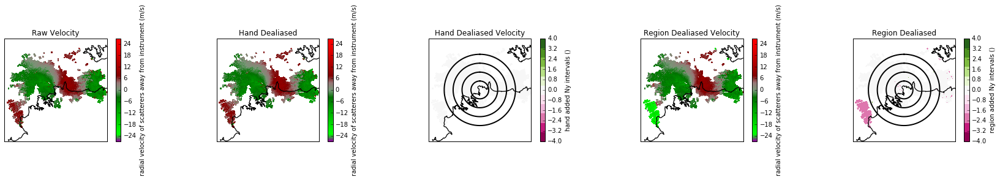

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_213009_vt_unfolded_hand.cfrad.nc


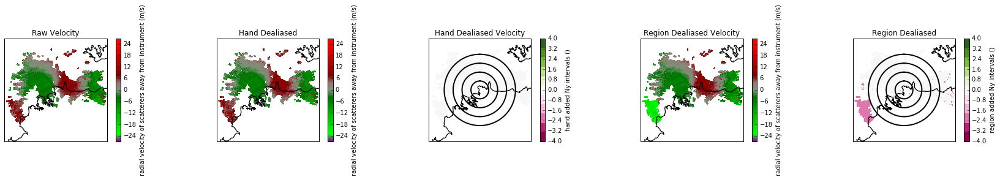

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_214009_vt_unfolded_hand.cfrad.nc


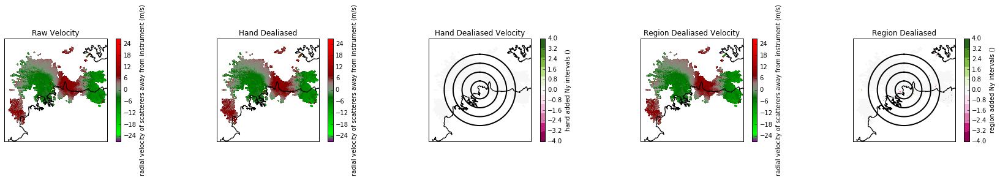

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_215009_vt_unfolded_hand.cfrad.nc


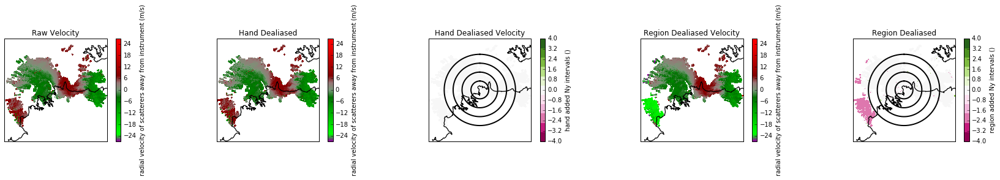

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_220009_vt_unfolded_hand.cfrad.nc


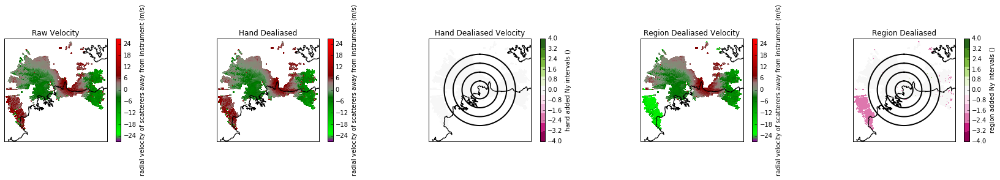

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_221011_vt_unfolded_hand.cfrad.nc


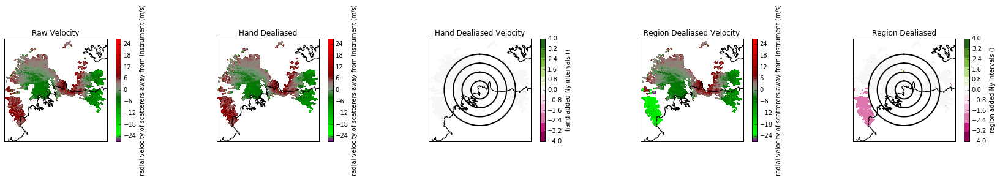

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_222009_vt_unfolded_hand.cfrad.nc


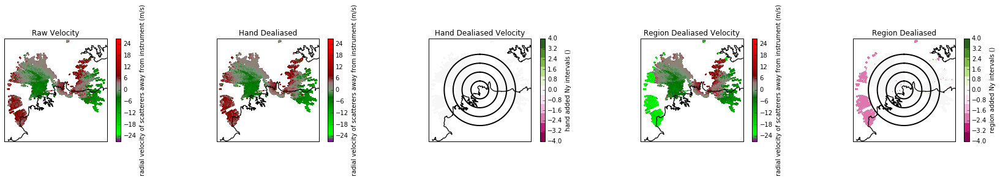

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_223008_vt_unfolded_hand.cfrad.nc


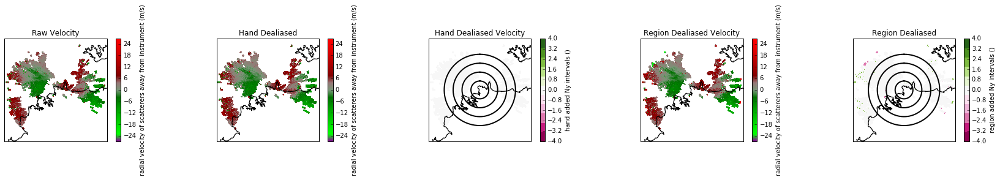

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_224008_vt_unfolded_hand.cfrad.nc


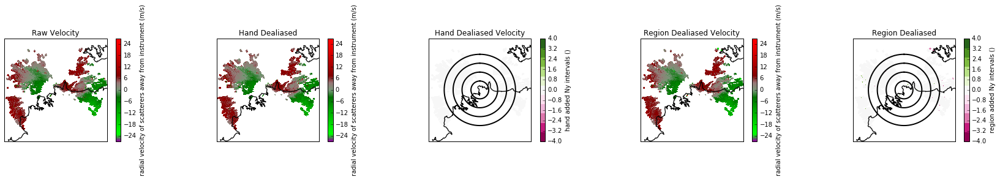

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_225008_vt_unfolded_hand.cfrad.nc


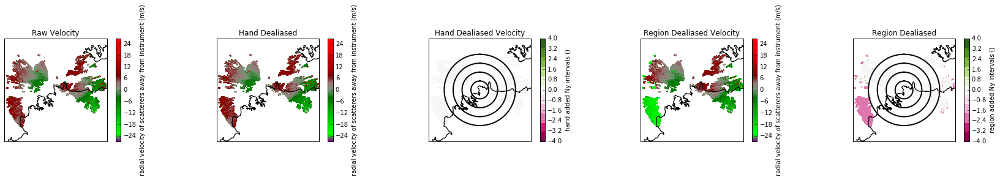

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_230009_vt_unfolded_hand.cfrad.nc


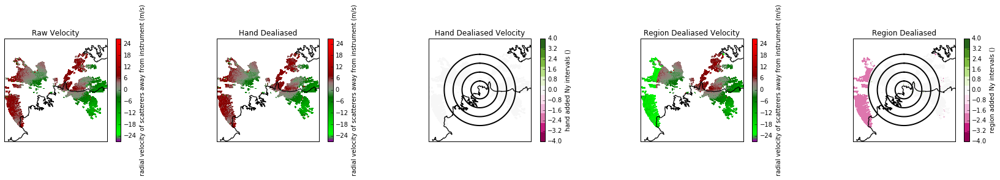

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_231011_vt_unfolded_hand.cfrad.nc


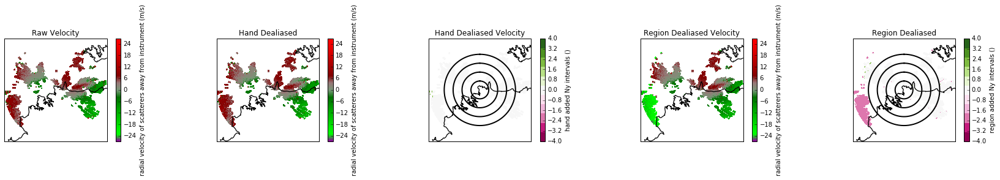

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_232009_vt_unfolded_hand.cfrad.nc


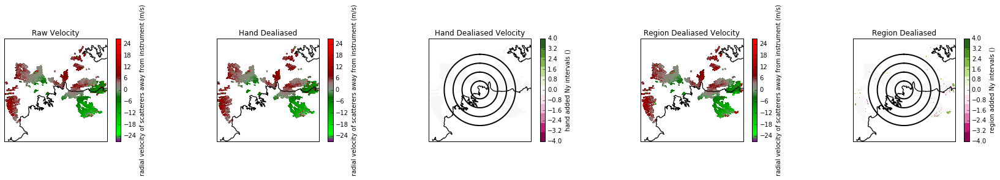

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_233009_vt_unfolded_hand.cfrad.nc


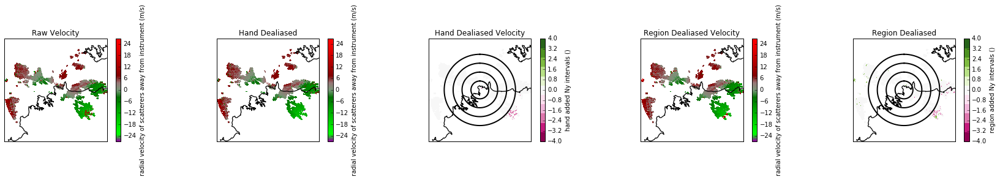

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_234009_vt_unfolded_hand.cfrad.nc


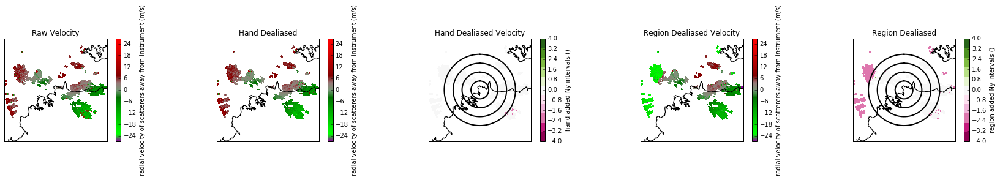

/home/zsherman/Documents/Jupyter/CSU_unfolded/CPOL_corr_20060122_235009_vt_unfolded_hand.cfrad.nc


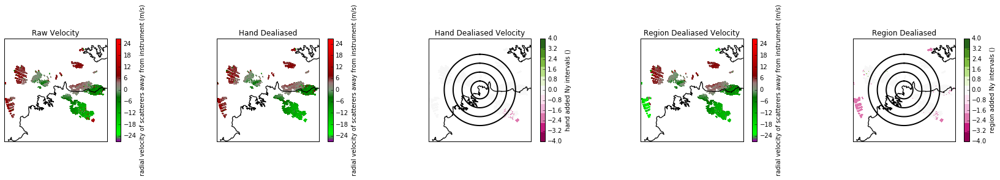

In [10]:
#Reading all files with pyart
#Plotting the raw velocity data for all files.
out_path1 = '/home/zsherman/Documents/Jupyter/CSU_unfolded/Images/All_Sweeps_Combination/'
d_cmap = cm.get_cmap('PiYG', 11)
radar_files = []
for filename in filenames:
    radar_file = pyart.io.read(filename)
    radar_files += [radar_file]
    print(filename)
    ny_vel = radar_file.instrument_parameters['nyquist_velocity']['data'][0]
    
    sw_sel = 0
    sw_num = radar_file.nsweeps
    sw_elevs = [radar_file.fixed_angle['data'][sw] for sw in range(0, sw_num-1)]
    el_sel = sw_elevs[sw_sel]
    
    cv_attribute_name = ''
    if ('corrected_velocity' in radar_file.fields):
        cv_attribute_name = 'corrected_velocity'
    elif ('corrected_velocity2' in radar_file.fields):
        cv_attribute_name = 'corrected_velocity2'
    else:
        raise Exception('key not found')
    
    display = pyart.graph.RadarMapDisplay(radar_file)
    fig = plt.figure(figsize = [30,3])
    ax = fig.add_subplot(151)
    display.plot_ppi_map('velocity', resolution = 'i', ax=ax, title='Raw Velocity',
                        mask_outside = False,
                        cmap = pyart.graph.cm.NWSVel,
                        vmin = -2*ny_vel, vmax = 2*ny_vel)
 
    display = pyart.graph.RadarMapDisplay(radar_file)  
    ax = fig.add_subplot(152)
    display.plot_ppi_map(cv_attribute_name, resolution = 'i', ax=ax, title='Hand Dealiased',
                        vmin = -2*ny_vel, vmax = 2*ny_vel, mask_outside = False,
                        cmap = pyart.graph.cm.NWSVel)
    
   
    corrected_velocity_region(radar_file)
    dealiasing_differences_func_hand(radar_file, ny_vel)
    
    display = pyart.graph.RadarMapDisplay(radar_file)
    ax = fig.add_subplot(153)
    display.plot_ppi_map('dealiasing_differences_sc_hand', vmin=-4, vmax=4, ax=ax, title='Hand Dealiased Velocity', mask_outside=False, cmap=d_cmap)
    display.plot_range_rings(range(25, 125, 25))
    display.plot_cross_hair(0.5)

    display = pyart.graph.RadarMapDisplay(radar_file)
    ax = fig.add_subplot(154)
    display.plot_ppi_map('corrected_velocity_region', resolution = 'i',
                        vmin = -2*ny_vel, vmax = 2*ny_vel, ax=ax, title='Region Dealiased Velocity',
                        colorbar_label='radial velocity of scatterers away from instrument (m/s)',
                        mask_outside = False,
                        cmap = pyart.graph.cm.NWSVel)
   
    dealiasing_differences_func_region(radar_file, ny_vel)
   
    display = pyart.graph.RadarMapDisplay(radar_file)
    ax = fig.add_subplot(155)
    display.plot_ppi_map('dealiasing_differences_sc_region', vmin=-4, vmax=4, ax=ax, title='Region Dealiased', mask_outside=False, cmap=d_cmap)
    display.plot_range_rings(range(25, 125, 25))
    display.plot_cross_hair(0.5)
 
    
    out_file1 = out_path1 + os.path.basename(filename).split('.', 1)[0]+ '_el%.0f' % (el_sel) + 'all_sweeps_combination.png'
    plt.savefig(out_file1, bbox_inches='tight')
    plt.show()

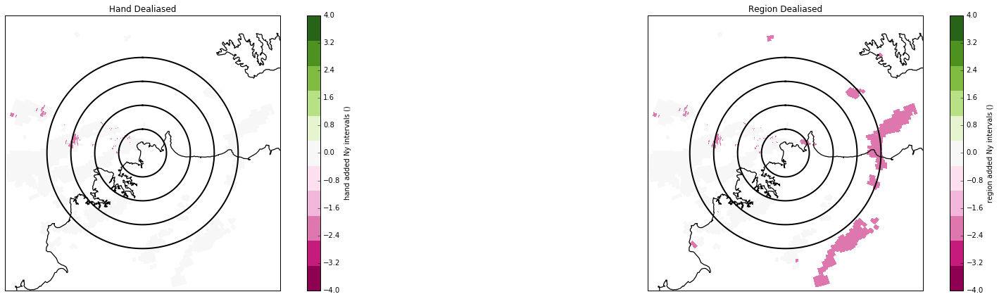

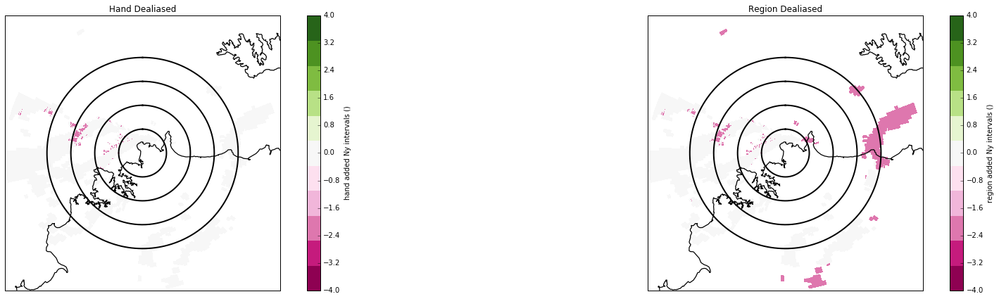

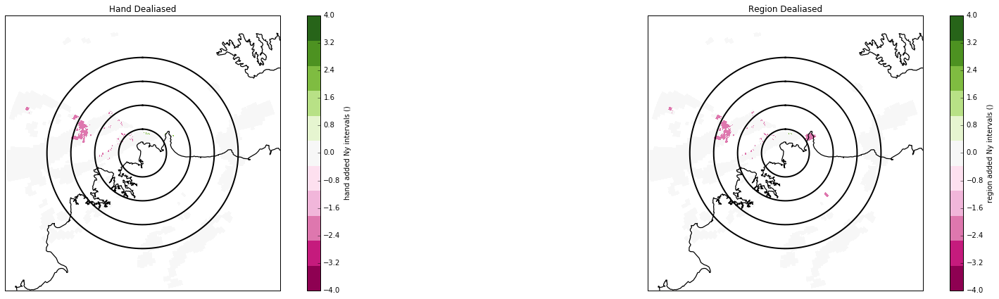

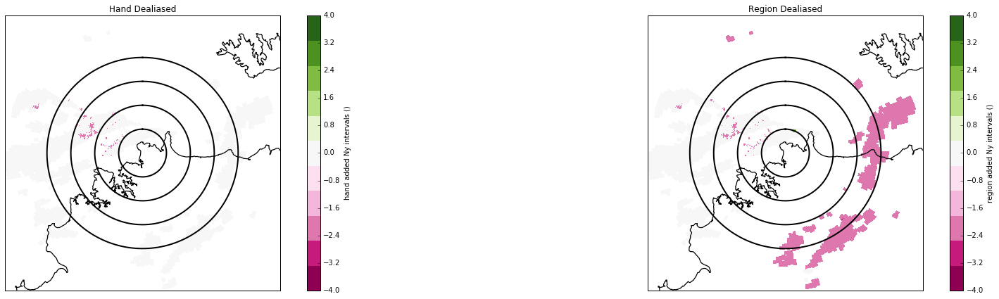

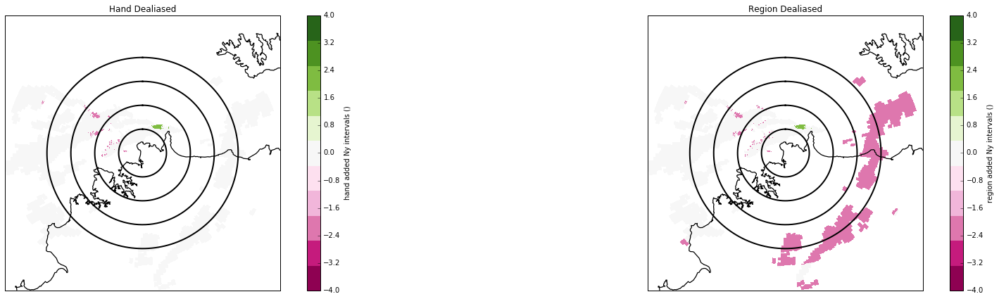

...

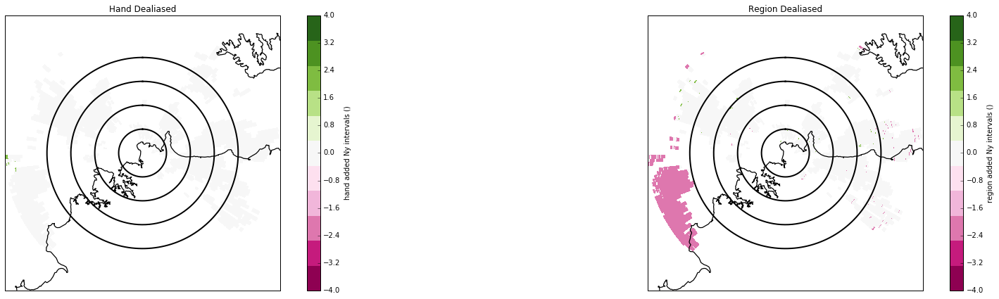

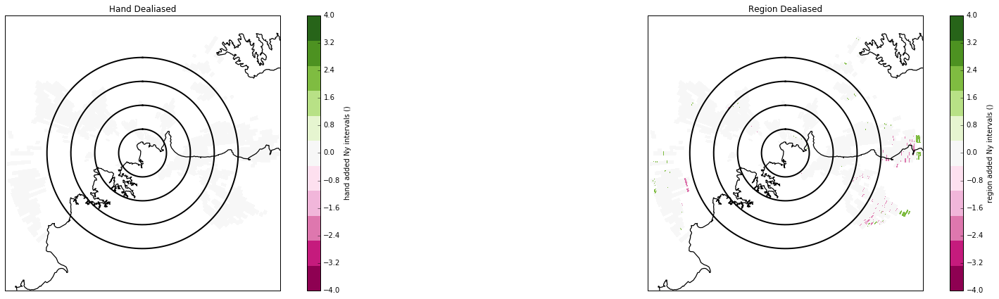

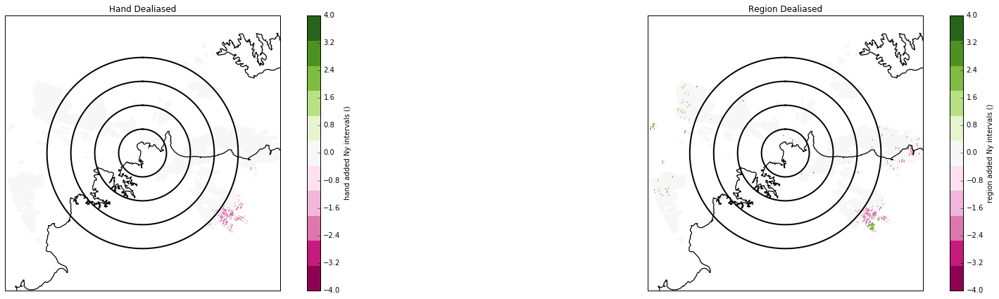

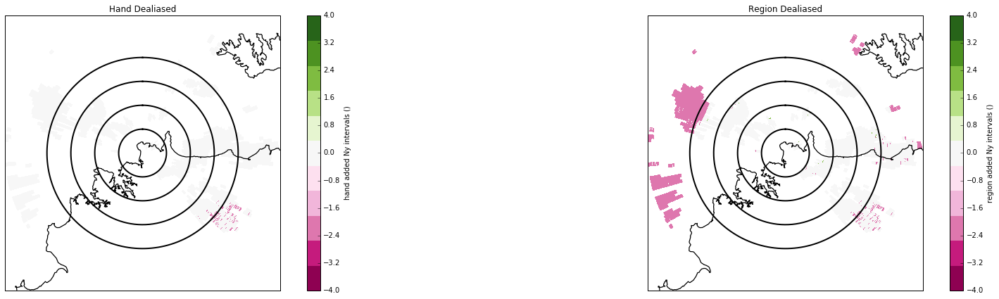

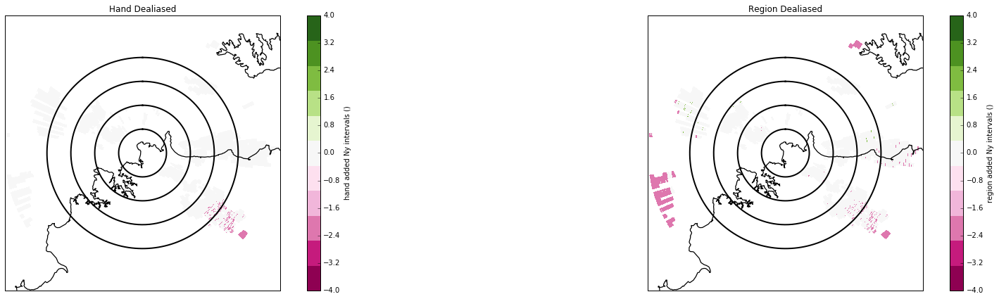

In [14]:
radar_files = []
for filename in filenames:
    radar_file = pyart.io.read(filename)
    radar_files += [radar_file]
    corrected_velocity_region(radar_file)
    ny_vel = radar_file.instrument_parameters['nyquist_velocity']['data'][0]
    dealiasing_differences_func_region(radar_file, ny_vel)
    #Putting each radar_file through the dealiasing difference function.
    dealiasing_differences_func_hand(radar_file, ny_vel)
    out_path_2 = '/home/zsherman/Documents/Jupyter/CSU_unfolded/Images/All_Sweeps_Comparison_Added_Nyquist/'
   
    d_cmap = cm.get_cmap('PiYG', 11)
    sw_sel = 0
    sw_num = radar_file.nsweeps
    sw_elevs = [radar_file.fixed_angle['data'][sw] for sw in range(0, sw_num-1)]
    el_sel = sw_elevs[sw_sel]
    

    display = pyart.graph.RadarMapDisplay(radar_file)
    fig = plt.figure(figsize=(30,7), dpi=80, facecolor='w', edgecolor='k')
    ax = fig.add_subplot(122)
    display.plot_ppi_map('dealiasing_differences_sc_region', vmin=-4, vmax=4, ax=ax, title='Region Dealiased', mask_outside=False, cmap=d_cmap)
    display.plot_range_rings(range(25, 125, 25))
    display.plot_cross_hair(0.5)
    
    display = pyart.graph.RadarMapDisplay(radar_file)
    ax = fig.add_subplot(121)
    display.plot_ppi_map('dealiasing_differences_sc_hand', vmin=-4, vmax=4, ax=ax, title='Hand Dealiased', mask_outside=False, cmap=d_cmap)
    display.plot_range_rings(range(25, 125, 25))
    display.plot_cross_hair(0.5)
    out_file_2 = out_path_2 + os.path.basename(filename).split('.', 1)[0]+ '_el%.0f' % (el_sel) + 'all_sweeps_comparison_added_nyquist.png'
    plt.savefig(out_file_2,  bbox_inches='tight')
    plt.show()